In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pydotplus, graphviz
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_graphviz
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from six import StringIO  
from IPython.display import Image
from scipy import stats

    1. Load the data from CSV

In [2]:
data = pd.read_csv('../US_Heart_Patients.csv',index_col=0)

    2. Perform the exploratory data analysis


        2.1. First 10 rows of the data

In [3]:
data.head(10)

,age,education,currentSmoker,cigsPerDay,BP Meds,prevalentStroke,prevalentHyp,diabetes,tot cholesterol,Systolic BP,Diastolic BP,BMI,heartRate,glucose,Heart-Att
Gender,,,,,,,,,,,,,,,
Male,39.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,195.0,106.0,70.0,26.97,80.0,77.0,0
Female,46.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,250.0,121.0,81.0,28.73,95.0,76.0,0
Male,48.0,1.0,1.0,20.0,0.0,0.0,0.0,0.0,245.0,127.5,80.0,25.34,75.0,70.0,0
Female,61.0,3.0,1.0,30.0,0.0,0.0,1.0,0.0,225.0,150.0,95.0,28.58,65.0,103.0,1
Female,46.0,3.0,1.0,23.0,0.0,0.0,0.0,0.0,285.0,130.0,84.0,23.10,85.0,85.0,0
Female,43.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,228.0,180.0,110.0,30.30,77.0,99.0,0
Female,63.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,205.0,138.0,71.0,33.11,60.0,85.0,1
Female,45.0,2.0,1.0,20.0,0.0,0.0,0.0,0.0,313.0,100.0,71.0,21.68,79.0,78.0,0
Male,52.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,260.0,141.5,89.0,26.36,76.0,79.0,0


        Check the shape i.e. dimension of data

In [4]:
data.shape

(4240, 15)

        2.2. 5-point summary (like Median, 25%, 75%, Minimum and Maximum)

In [5]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
age,4238.0,49.579283,8.572875,32.00,42.00,49.000,56.00,70.0
education,4130.0,1.979903,1.019943,1.00,1.00,2.000,3.00,4.0
currentSmoker,4237.0,0.494218,0.500026,0.00,0.00,0.000,1.00,1.0
cigsPerDay,4209.0,9.001901,11.920742,0.00,0.00,0.000,20.00,70.0
BP Meds,4180.0,0.029665,0.169682,0.00,0.00,0.000,0.00,1.0
prevalentStroke,4231.0,0.005909,0.076650,0.00,0.00,0.000,0.00,1.0
prevalentHyp,4238.0,0.310524,0.462763,0.00,0.00,0.000,1.00,1.0
diabetes,4238.0,0.025720,0.158316,0.00,0.00,0.000,0.00,1.0
tot cholesterol,4180.0,236.677273,44.616098,107.00,206.00,234.000,263.00,696.0
Systolic BP,4236.0,132.362370,22.039244,83.50,117.00,128.000,144.00,295.0


        2.3. Information about the column (data types)

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4240 entries, Male to Female
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   age              4238 non-null   float64
 1   education        4130 non-null   float64
 2   currentSmoker    4237 non-null   float64
 3   cigsPerDay       4209 non-null   float64
 4   BP Meds          4180 non-null   float64
 5   prevalentStroke  4231 non-null   float64
 6   prevalentHyp     4238 non-null   float64
 7   diabetes         4238 non-null   float64
 8   tot cholesterol  4180 non-null   float64
 9   Systolic BP      4236 non-null   float64
 10  Diastolic BP     4235 non-null   float64
 11  BMI              4216 non-null   float64
 12  heartRate        4236 non-null   float64
 13  glucose          3849 non-null   float64
 14  Heart-Att        4240 non-null   int64  
dtypes: float64(14), int64(1)
memory usage: 530.0+ KB


     2.4. Check the How many rows of data are having heart risk

In [7]:
data['Heart-Att'].value_counts()       

Heart-Att
0    3596
1     644
Name: count, dtype: int64

        2.5. Check if any duplicate rows present or now

In [8]:
data.duplicated().sum()

0

        2.6. Number of outliers(extra points)

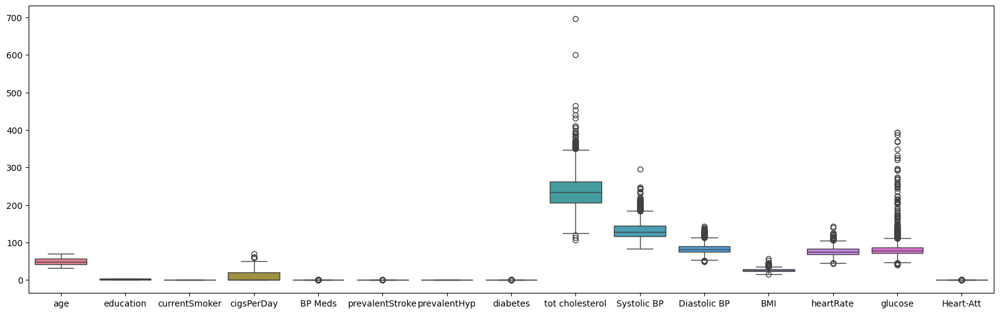

In [9]:
plt.figure(figsize=(20, 6))
sns.boxplot(data=data)
plt.show()

In [10]:
z_scores = stats.zscore(data)
outliers = (abs(z_scores) > 3).any(axis=1)

# Remove rows with outliers
data_no_outliers = data[~outliers].reset_index(drop=True)
data = data_no_outliers

            Checking box plot after removing outlier

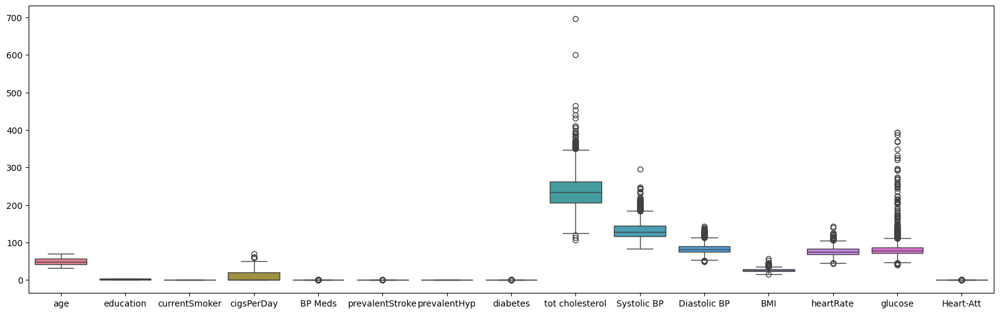

In [11]:
plt.figure(figsize=(20, 6))
sns.boxplot(data=data)
plt.show()

        2.5. Any missing value

In [12]:
print(data.isnull().sum())

age                  2
education          110
currentSmoker        3
cigsPerDay          31
BP Meds             60
prevalentStroke      9
prevalentHyp         2
diabetes             2
tot cholesterol     60
Systolic BP          4
Diastolic BP         5
BMI                 24
heartRate            4
glucose            391
Heart-Att            0
dtype: int64


        2.6. Correlation between variables

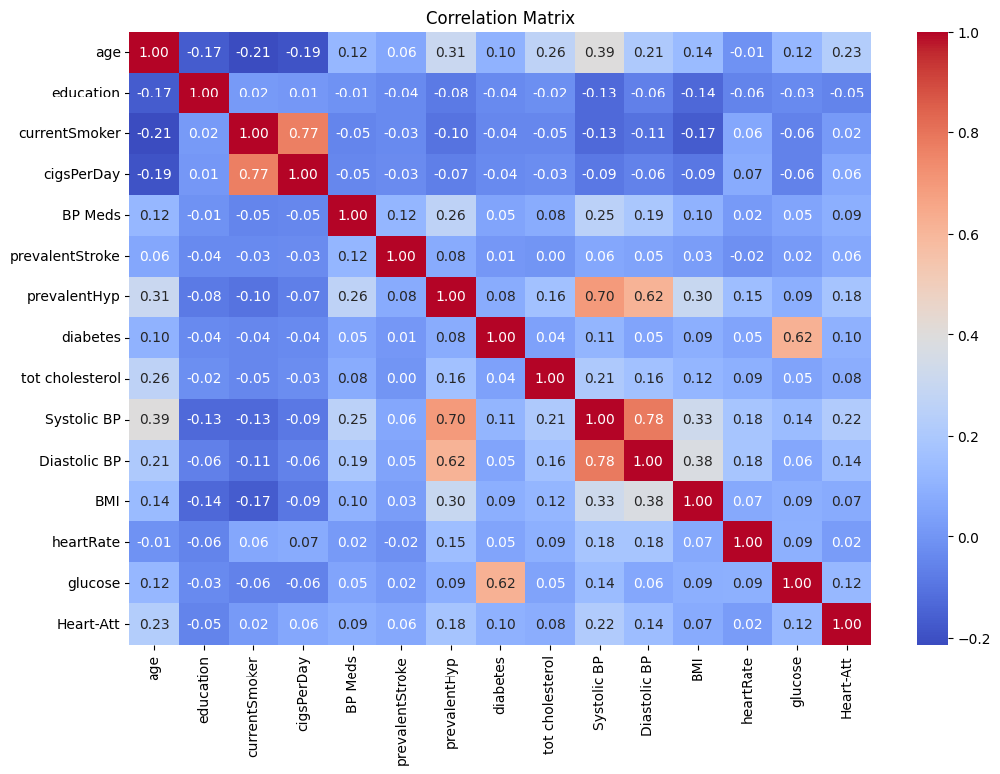

In [13]:
correlation_matrix = data.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

        2.7. Distribution of Variables

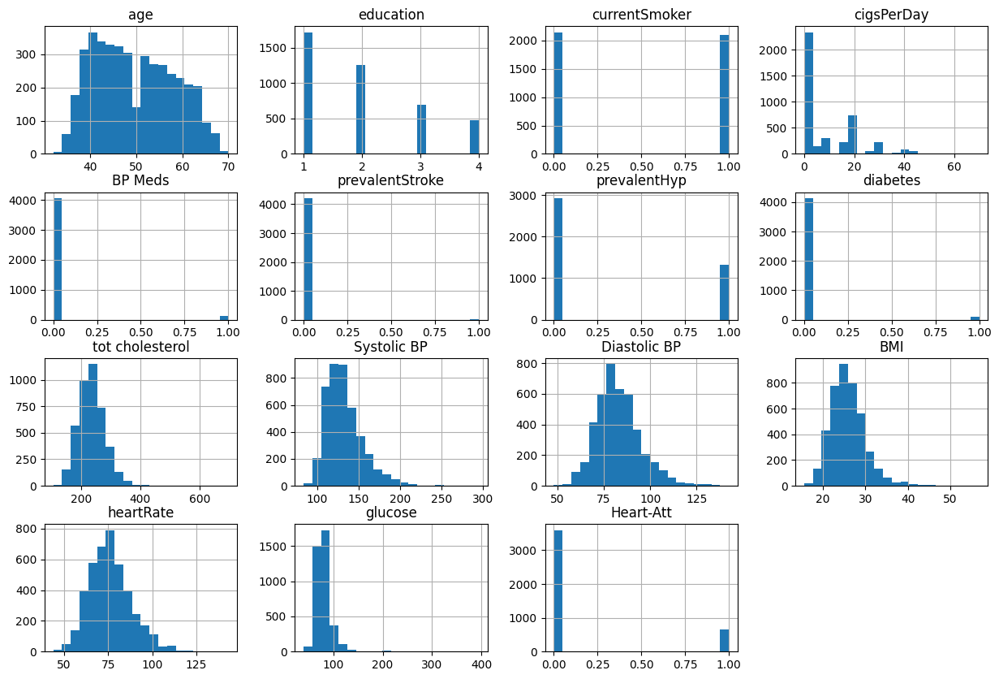

In [14]:
data.hist(figsize=(15, 10), bins=20)
plt.show()

    3. Data Preprocessing

        3.1. Impute the missing values (if any).

In [15]:
imputer = SimpleImputer(strategy='mean')
data_imputed = pd.DataFrame(imputer.fit_transform(data), columns=data.columns)


        Check if any missing value after impute

In [16]:
print(data_imputed.isnull().sum())
data = data_imputed

age                0
education          0
currentSmoker      0
cigsPerDay         0
BP Meds            0
prevalentStroke    0
prevalentHyp       0
diabetes           0
tot cholesterol    0
Systolic BP        0
Diastolic BP       0
BMI                0
heartRate          0
glucose            0
Heart-Att          0
dtype: int64


                3.2. Outlier treatment

    Checking the outlier before treatment

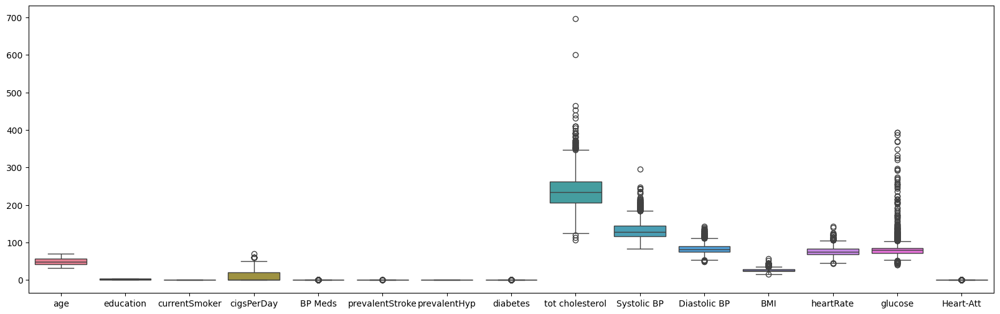

In [17]:
plt.figure(figsize=(20, 6))
sns.boxplot(data=data)
plt.show()

    Removing Outliers 

In [18]:
def outlier_cap(col):
    sorted(col)
    Q1, Q3 =np.percentile(col,[25,75])
    IQR = Q3 - Q1
    lower_range = Q1 - (1.5*IQR)
    upper_range = Q3 + (1.5*IQR)
    return lower_range, upper_range

In [19]:
for column in data.columns[:-1].tolist():
    lr, ur =outlier_cap(data[column])
    data[column] =np.where(data[column]>ur , ur,data[column])
    data[column] =np.where(data[column]<lr , lr,data[column])

    Showing box plot after removing all outliers

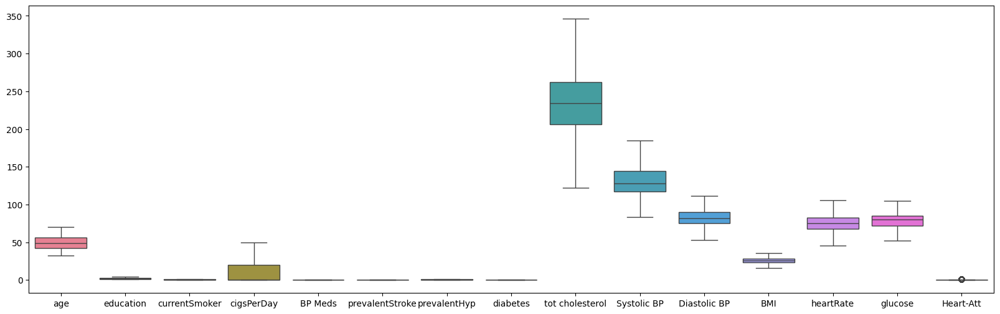

In [20]:
plt.figure(figsize=(20, 6))
sns.boxplot(data=data)
plt.show()

        4. Split the dataset: 

            4.1. Spliting feature and response 

In [21]:
# Putting feature variable to X
X = data.drop('Heart-Att',axis=1)

# Putting response variable to y
y = data['Heart-Att']

            4.2. Split the data into 80% training dataset and 20% test dataset

In [22]:
X_train, X_test, y_train, y_test = train_test_split(X,y,train_size=0.8, random_state=42)
X_train.shape, X_test.shape

((3392, 14), (848, 14))

        5. Model preparation and evaluation 

            5.1. Train the model with test data ( without hyper-parameters )

In [23]:
dt_default = DecisionTreeClassifier(random_state=42)
dt_default.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

            5.2. Creating helper function and plotting the decision tree

In [24]:
def get_dt_graph(dt_classifier):
    dot_data = StringIO()
    export_graphviz(dt_classifier, out_file=dot_data, filled=True,rounded=True,
                    feature_names=X.columns, 
                    class_names=['Risk', "No Risk"])
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    return graph

In [25]:
gph = get_dt_graph(dt_default)
Image(gph.create_png())

            5.3. Creating confusion matrix to evaluate the performance

In [26]:
def evaluate_model(dt_classifier):
    print("Train Accuracy :", accuracy_score(y_train, dt_classifier.predict(X_train)))
    print("Train Confusion Matrix:")
    print(confusion_matrix(y_train, dt_classifier.predict(X_train)))
    print("-"*50)
    print("Test Accuracy :", accuracy_score(y_test, dt_classifier.predict(X_test)))
    print("Test Confusion Matrix:")
    print(confusion_matrix(y_test, dt_classifier.predict(X_test)))
    print(classification_report(y_test, dt_classifier.predict(X_test)))

In [27]:
evaluate_model(dt_default)

Train Accuracy : 1.0
Train Confusion Matrix:
[[2871    0]
 [   0  521]]
--------------------------------------------------
Test Accuracy : 0.7393867924528302
Test Confusion Matrix:
[[607 118]
 [103  20]]
              precision    recall  f1-score   support

         0.0       0.85      0.84      0.85       725
         1.0       0.14      0.16      0.15       123

    accuracy                           0.74       848
   macro avg       0.50      0.50      0.50       848
weighted avg       0.75      0.74      0.75       848



        6. Finding the best model with Hyper-paramete

            6.1. Controlling the depth of the tree  

In [28]:
dt_depth = DecisionTreeClassifier(max_depth=3)
dt_depth.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3)

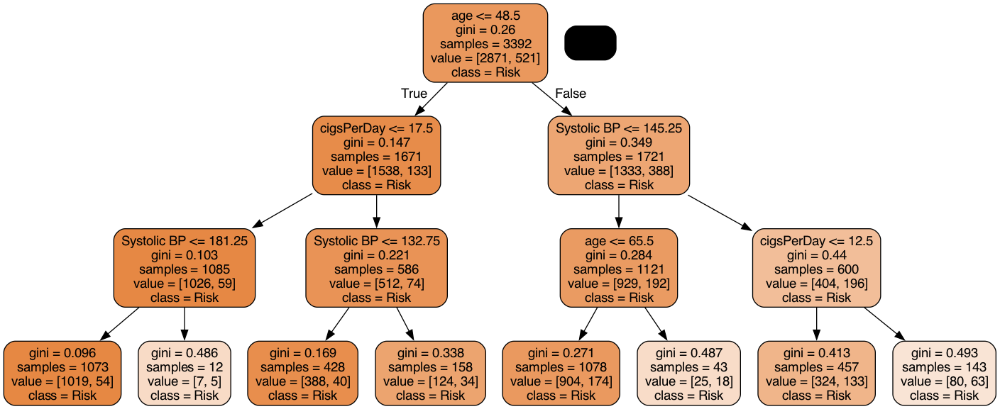

In [29]:
gph = get_dt_graph(dt_depth)
Image(gph.create_png())

In [30]:
evaluate_model(dt_depth)

Train Accuracy : 0.8464033018867925
Train Confusion Matrix:
[[2871    0]
 [ 521    0]]
--------------------------------------------------
Test Accuracy : 0.8549528301886793
Test Confusion Matrix:
[[725   0]
 [123   0]]
              precision    recall  f1-score   support

         0.0       0.85      1.00      0.92       725
         1.0       0.00      0.00      0.00       123

    accuracy                           0.85       848
   macro avg       0.43      0.50      0.46       848
weighted avg       0.73      0.85      0.79       848



/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

            6.3. Controlling minimum samples before split 

In [31]:
dt_min_split = DecisionTreeClassifier(min_samples_split=25)
dt_min_split.fit(X_train, y_train)

DecisionTreeClassifier(min_samples_split=25)

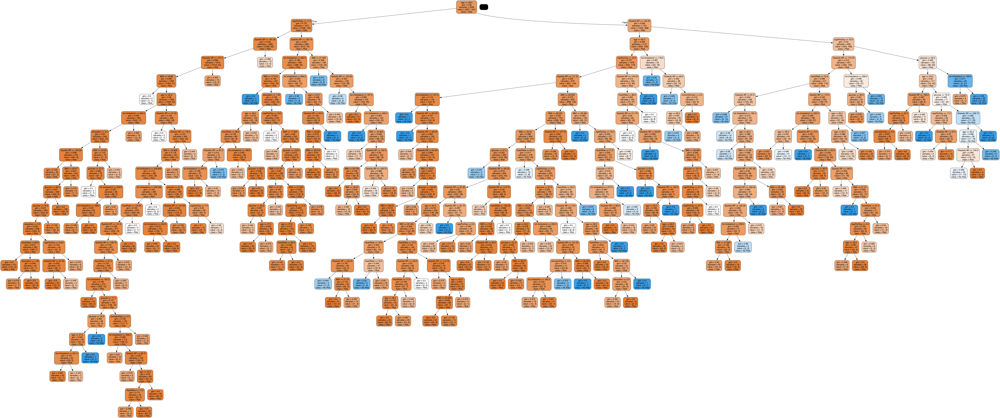

In [32]:
gph = get_dt_graph(dt_min_split)
Image(gph.create_png())

In [33]:
evaluate_model(dt_depth)

Train Accuracy : 0.8464033018867925
Train Confusion Matrix:
[[2871    0]
 [ 521    0]]
--------------------------------------------------
Test Accuracy : 0.8549528301886793
Test Confusion Matrix:
[[725   0]
 [123   0]]
              precision    recall  f1-score   support

         0.0       0.85      1.00      0.92       725
         1.0       0.00      0.00      0.00       123

    accuracy                           0.85       848
   macro avg       0.43      0.50      0.46       848
weighted avg       0.73      0.85      0.79       848



/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

            6.3. Controlling minimum samples of leaf node 

In [34]:
dt_min_leaf = DecisionTreeClassifier(min_samples_leaf=20, random_state=42)
dt_min_leaf.fit(X_train, y_train)

DecisionTreeClassifier(min_samples_leaf=20, random_state=42)

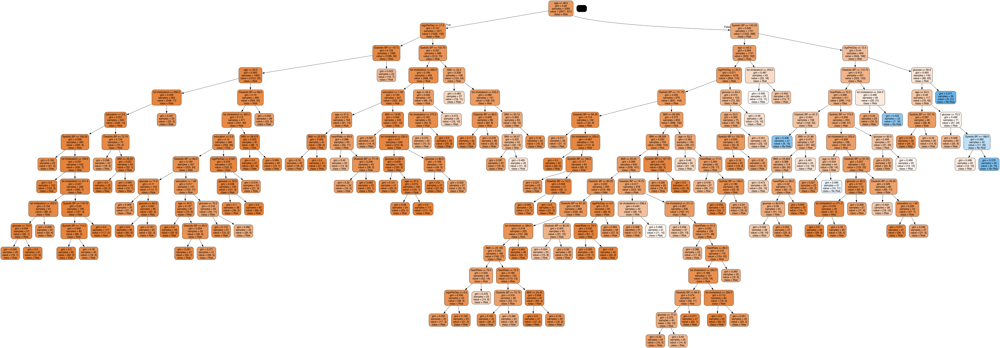

In [35]:
gph = get_dt_graph(dt_min_leaf)
Image(gph.create_png())

In [36]:
evaluate_model(dt_min_leaf)

Train Accuracy : 0.8596698113207547
Train Confusion Matrix:
[[2838   33]
 [ 443   78]]
--------------------------------------------------
Test Accuracy : 0.8360849056603774
Test Confusion Matrix:
[[704  21]
 [118   5]]
              precision    recall  f1-score   support

         0.0       0.86      0.97      0.91       725
         1.0       0.19      0.04      0.07       123

    accuracy                           0.84       848
   macro avg       0.52      0.51      0.49       848
weighted avg       0.76      0.84      0.79       848



            6.3. Using Entrophy instead of gini index

In [37]:
dt_min_leaf_entrophy = DecisionTreeClassifier(min_samples_leaf=20, random_state=42, criterion='entropy')
dt_min_leaf_entrophy.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_samples_leaf=20,
                       random_state=42)

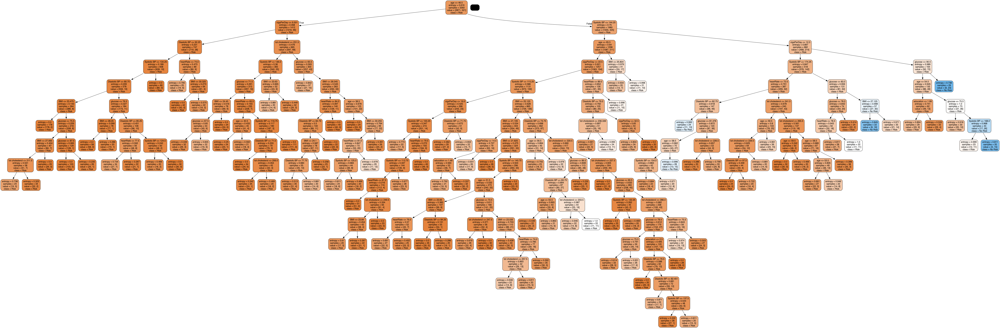

In [38]:
gph = get_dt_graph(dt_min_leaf_entrophy)
Image(gph.create_png())

In [39]:
evaluate_model(dt_min_leaf)

Train Accuracy : 0.8596698113207547
Train Confusion Matrix:
[[2838   33]
 [ 443   78]]
--------------------------------------------------
Test Accuracy : 0.8360849056603774
Test Confusion Matrix:
[[704  21]
 [118   5]]
              precision    recall  f1-score   support

         0.0       0.86      0.97      0.91       725
         1.0       0.19      0.04      0.07       123

    accuracy                           0.84       848
   macro avg       0.52      0.51      0.49       848
weighted avg       0.76      0.84      0.79       848



            7. Hyper parameter tuning

In [40]:
from sklearn.model_selection import GridSearchCV

In [41]:
dt = DecisionTreeClassifier(random_state=42)

In [42]:
# Create the parameter grid based on the results of random search 
params = {
    'max_depth': [2, 3, 5, 10, 20],
    'min_samples_leaf': [5, 10, 20, 50, 100],
    'criterion': ["gini", "entropy"]
}

In [43]:
# Instantiate the grid search model
grid_search = GridSearchCV(estimator=dt, 
                           param_grid=params, 
                           cv=4, n_jobs=-1, verbose=1, scoring = "accuracy")

In [44]:
%%time
grid_search.fit(X_train, y_train)

Fitting 4 folds for each of 50 candidates, totalling 200 fits


CPU times: user 165 ms, sys: 86.1 ms, total: 251 ms
Wall time: 2.14 s


GridSearchCV(cv=4, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100]},
             scoring='accuracy', verbose=1)

In [45]:
score_df = pd.DataFrame(grid_search.cv_results_)
score_df.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,0.007721,0.001042,0.002371,0.000809,gini,2,5,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.846698,0.846698,0.844340,0.845519,0.845814,0.000978,22
1,0.007654,0.000770,0.005316,0.003087,gini,2,10,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.846698,0.846698,0.844340,0.845519,0.845814,0.000978,22
2,0.003048,0.000091,0.000764,0.000008,gini,2,20,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
3,0.002862,0.000122,0.000716,0.000039,gini,2,50,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
4,0.002808,0.000105,0.000696,0.000032,gini,2,100,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1


In [46]:
score_df.nlargest(5,"mean_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
2,0.003048,0.000091,0.000764,0.000008,gini,2,20,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
3,0.002862,0.000122,0.000716,0.000039,gini,2,50,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
4,0.002808,0.000105,0.000696,0.000032,gini,2,100,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
9,0.004240,0.000889,0.000782,0.000042,gini,3,100,"{'criterion': 'gini', 'max_depth': 3, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1
14,0.006455,0.002109,0.001069,0.000600,gini,5,100,"{'criterion': 'gini', 'max_depth': 5, 'min_sam...",0.846698,0.846698,0.846698,0.845519,0.846403,0.000511,1


In [47]:
grid_search.best_estimator_

DecisionTreeClassifier(max_depth=2, min_samples_leaf=20, random_state=42)

In [48]:
dt_best = grid_search.best_estimator_

In [49]:
evaluate_model(dt_best)

Train Accuracy : 0.8464033018867925
Train Confusion Matrix:
[[2871    0]
 [ 521    0]]
--------------------------------------------------
Test Accuracy : 0.8549528301886793
Test Confusion Matrix:
[[725   0]
 [123   0]]
              precision    recall  f1-score   support

         0.0       0.85      1.00      0.92       725
         1.0       0.00      0.00      0.00       123

    accuracy                           0.85       848
   macro avg       0.43      0.50      0.46       848
weighted avg       0.73      0.85      0.79       848



/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

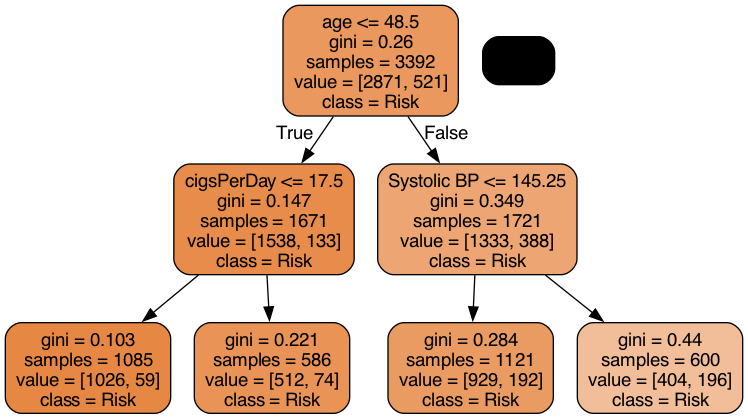

In [50]:
gph = get_dt_graph(dt_best)
Image(gph.create_png())